<a href="https://colab.research.google.com/github/YasmineeBa/Road-Object-Detection-and-distance-estimation-using-depth-monocular-model/blob/main/Detectro2_Mask_RCNN_combinev4_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Detectron2 with Mask R-CNN using bdd10k dataset combined with mappilary dataset for road object detection.

* this notbook goes throught how train bdd10k dataset combined with somme images of mappilary dataset with detectron2 using mask r-cnn model.

In other word, using computer vision to detect road object for self driving car.

In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


* import our dataset

In [ ]:
import shutil

shutil.copyfile("/content/drive/MyDrive/bdd100k/new/datasetv4.zip","/content/datasetv4.zip")
!unzip datasetv4.zip -d /content/images10K

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  inflating: /content/images10K/images/000000265333.jpg  
  inflating: /content/images10K/images/000000553998.jpg  
  inflating: /content/images10K/images/000000047357.jpg  
  inflating: /content/images10K/images/a37192a8-b04db02d.jpg  
  inflating: /content/images10K/images/68bbe388-a040087c.jpg  
  inflating: /content/images10K/images/000000257118.jpg  
  inflating: /content/images10K/images/000000351876.jpg  
  inflating: /content/images10K/images/8503e27b-35dd625c.jpg  
  inflating: /content/images10K/images/000000460728.jpg  
  inflating: /content/images10K/images/7c67d03c-c77e4d7a.jpg  
  inflating: /content/images10K/images/60c53601-d8a36f6a.jpg  
  inflating: /content/images10K/images/5d03a12f-84294c67.jpg  
  inflating: /content/images10K/images/7d4a9094-0455564b.jpg  
  inflating: /content/images10K/images/18e598f0-13810000.jpg  
  inflating: /content/images10K/images/000000340004.jpg  
  inflating:

* first let's get the dependencies we need

In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-g3gqktn1
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-g3gqktn1
  Resolved https://github.com/facebookresearch/fvcore.git to commit fcc14bb0016408ddd818ddb0998f3df0e4e1381c
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.6-py3-none-any.whl size=65380 sha256=454e71c951d7511c5d105cb1ac8ae4c056ef6bf1d569f5e1df51ecb4854f6372
  Stored in directory: /tmp/pip-ephem-wheel-cache-uf_jyv3a/wheels/8f/cb/6a/3b7ac0e01781855ca3d1417ebf9e15e20d5b7fe37ab063aa50
  Created wheel for iopath: filename=

'2.0.1+cu118'

* install detectron2 on colab

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 12.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=0b54f0836873992a1c2cad38a014baab2ddf9b84d531fa3df3174db71ee3d294
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatibl

**Note:** After running the above two cells, you may need to restart your runtime (Runtime -> Restart runtime). After doing so, you can run the cells below as normal.

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger() # this logs Detectron2 information such as what the model is doing when it's training

# import some common libraries
import numpy as np
import pandas as pd
from tqdm import tqdm
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo # a series of pre-trained Detectron2 models: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md
from detectron2.engine import DefaultPredictor # a default predictor class to make predictions on an image using a trained model
from detectron2.config import get_cfg # a config of "cfg" in Detectron2 is a series of instructions for building a model
from detectron2.utils.visualizer import Visualizer # a class to help visualize Detectron2 predictions on an image
from detectron2.data import MetadataCatalog, DatasetCatalog # stores information about the model such as what the training/test data is, what the class names are

In [ ]:
import json
f = open('/content/images10K/bdd100k_v4.json')
data = json.load(f)

In [ ]:
data.keys()

dict_keys(['images', 'categories', 'annotations'])

* total number of images is equal to 11871

In [ ]:
len(data['images'])

11871

* register data_train with register_coco_instance()

# How to train your own custom model

Detectron2 comes with a [fair few pretrained models](https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md) on the [COCO dataset (common objects in context)](http://cocodataset.org/#home) but if you're like me, you're probably most interested in training on your own data.

The beautiful thing is, thanks to transfer learning, we can take the patterns the pretrained Detectron2 models have learned from the COCO dataset and update them with our own data.

To do so, we'll need to:
* Have our own data (this either exists already, or you'll have to collect it)
* Label our data in a compatiable format for Detectron2


 we'll be using public data from [bdd100k and mapilarry).

More specifially, to train our own custom model, we're going to do the following:
1. Download data (images) & label files from bdd100k and get some images from mappilarry
2. Format the data (images) & label files to be compatiable with Detectron2
3. Download a pretrained Detectron2 model and update it (train it) with our own data
4. Verify the updated model works on our own images by making predictions
5. Formalling evaluate the model using a validation/test set and Detectron2 evaluators

As we go through, you'll notice most of the work is in steps 1 & 2.

This is because once you have your data ready and formatted, it slots quite nicely into Detectron2's training procedure.

To start getting the data ready, since we're using bdd100k, we'll first download the dataset  

* Register the data val with Detectron2's DatasetCatalog
* create the metadata for our data_val

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("data_train", {}, "/content/images10K/bdd100k_v4.json", "/content/images10K/images")
metadata = MetadataCatalog.get("data_train")
dataset_dicts = DatasetCatalog.get("data_train")

[06/03 12:27:55 d2.data.datasets.coco]: Loading /content/images10K/bdd100k_v4.json takes 3.76 seconds.
WARNING [06/03 12:27:55 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/03 12:27:55 d2.data.datasets.coco]: Loaded 11871 images in COCO format from /content/images10K/bdd100k_v4.json
WARNING [06/03 12:27:56 d2.data.datasets.coco]: Filtered out 2 instances without valid segmentation. There might be issues in your dataset generation process.  Please check https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html carefully


* get the number of each instances per category

In [ ]:
from collections import defaultdict
# Count instances per category
instances_per_category = defaultdict(int)
for dataset_dict in dataset_dicts:
    for ann in dataset_dict['annotations']:
        cat_id = ann['category_id']
        instances_per_category[cat_id] += 1

# Print category information
print("Category ID | Category Name | Number of Instances")
print("------------------------------------------------")
for cat_id, count in instances_per_category.items():
    cat_name = metadata.thing_classes[cat_id]
    print(f"{cat_id:<11} | {cat_name:<14} | {count}")

Category ID | Category Name | Number of Instances
------------------------------------------------
3           | car            | 82712
1           | traffic sign   | 24423
2           | traffic light  | 17882
5           | motorcycle     | 1630
0           | person         | 11656
7           | bus            | 2813
4           | truck          | 5834
8           | bicycle        | 1885
6           | train          | 2131


### Viewing a custom image & labels

Now we've got our data labels created, let's paint them on one some of our images and make sure they look somewhat reasonable.

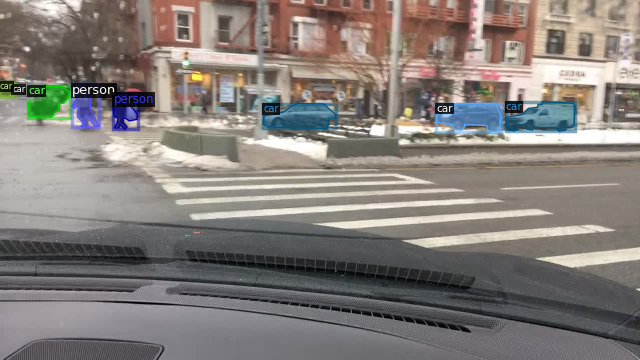

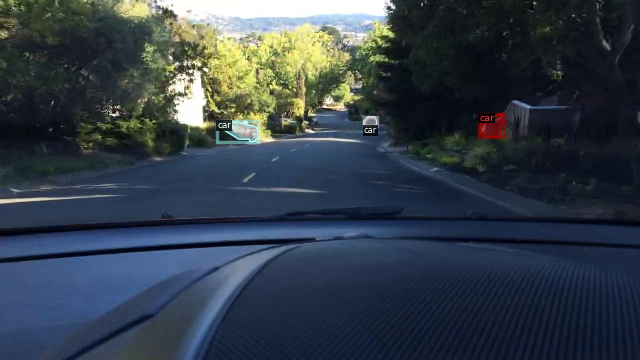

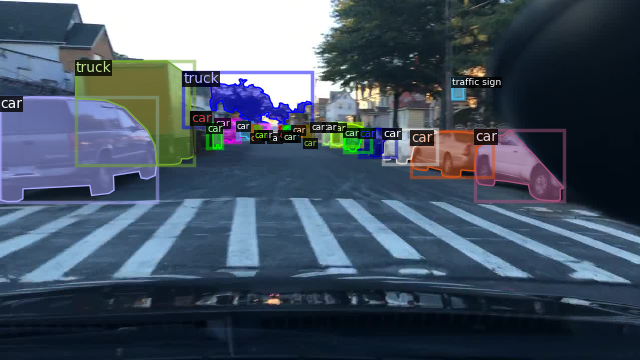

In [ ]:
import random
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

* prepare data validation

In [ ]:
import json
import random

# Load the original dataset json file
coco_data_file = '/content/images10K/bdd100k_v4.json'
with open(coco_data_file, 'r') as f:
    coco_data = json.load(f)

# Create an empty validation dataset
val_data = {'categories': coco_data['categories'], 'images': [], 'annotations': []}

# Get the total number of images
num_images = len(coco_data['images'])

# Calculate 10% of the total number of images
num_val_images = int(num_images * 0.1)

# Select a random sample of 10% of the images
selected_img_ids = random.sample([img['id'] for img in coco_data['images']], num_val_images)

# Add the selected images to the validation dataset
val_data['images'] = [img for img in coco_data['images'] if img['id'] in selected_img_ids]

# Get all annotations for the selected images
for ann in coco_data['annotations']:
    if ann['image_id'] in selected_img_ids:
        val_data['annotations'].append(ann)

# Save the new validation dataset
val_data_file = '/content/annotations_10.json'
with open(val_data_file, 'w') as f:
    json.dump(val_data, f)

* Register the data val with Detectron2's DatasetCatalog
* create the metadata for our data_val

In [ ]:
from detectron2.data.datasets import register_coco_instances
# Register the datasets with Detectron2's DatasetCatalog
register_coco_instances("dataval", {}, "/content/annotations_10.json", "/content/images10K/images")
# cretae metadata for our dataset and Setup metadata variable
metadata = MetadataCatalog.get("dataval")
dataset_dicts = DatasetCatalog.get("dataval")

WARNING [06/12 18:00:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/12 18:00:03 d2.data.datasets.coco]: Loaded 1187 images in COCO format from /content/annotations_10.json


### Get the final model weights from output directory that i registred in myDrive


In [ ]:
import shutil
shutil.copyfile("/content/drive/MyDrive/sharedFolder_aws/5th/model_0004899.pth","/content/model_0004899.pth")

'/content/model_0004899.pth'

### Making predictions with (inference) and evaluating a custom model

You might've noticed from the training outputs the evaluator wasn't found.

Before we build an evaluator, let's make some predictions with our trained model and visualize them. Remember: visualize, visualize, visualize.


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 9  # Update this with the number of classes in your dataset
cfg.MODEL.WEIGHTS = "/content/model_0004899.pth"  # # Get the final model weights from the outputs directory
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[06/03 12:28:57 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/model_0004899.pth ...


In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/content/model_0004899.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[06/03 12:29:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/model_0004899.pth ...


We can now use the predictor to make predictions and visualize different results. Visualizing predictions is always a good idea to make sure our model isn't spewing out gibberish.

Let's make some predictions on the validation set (the model has never seen these) and check them out.

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


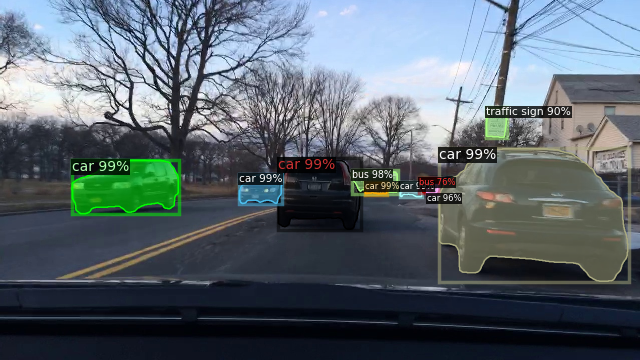

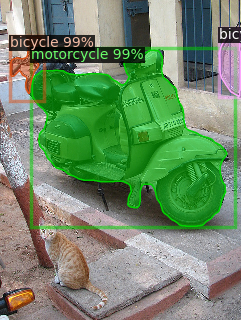

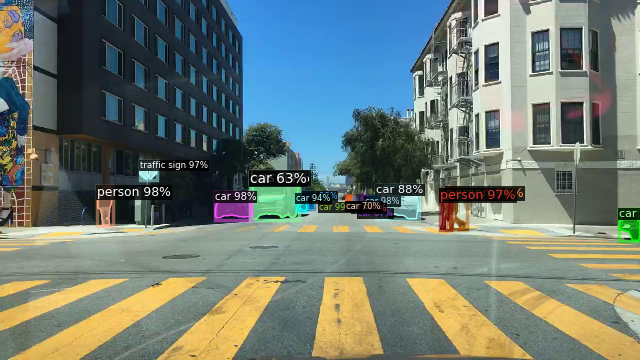

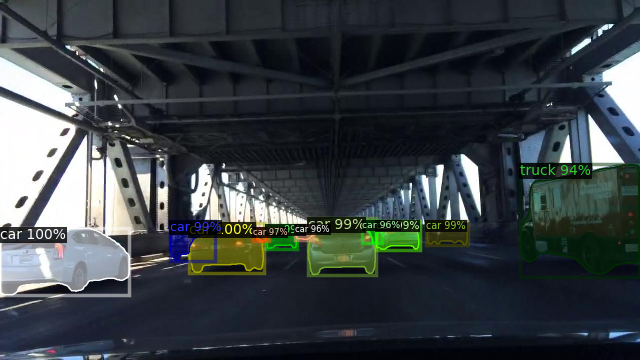

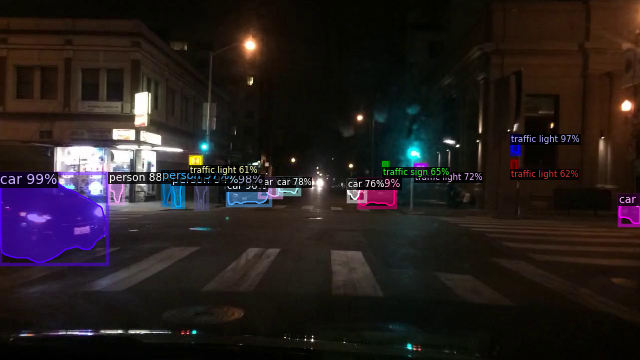

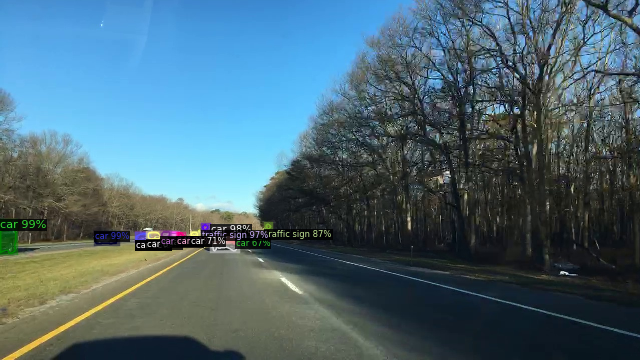

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 6):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=metadata,
                   scale=0.5,
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

## Evaluate a custom model

Our model is working on some of our custom data. Now let's get some metrics.

Since we're working on an object detection problem, we can use Detectron2's COCOEvaluater class ([COCO](http://cocodataset.org/#home), common objects in context, is the image dataset Detectron2 models are pretrained on).

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# Setup an evaluator, we use COCO because it's one of the standards for object detection: https://detectron2.readthedocs.io/modules/evaluation.html#detectron2.evaluation.COCOEvaluator
evaluator = COCOEvaluator("dataval", output_dir="./output")
#create a dataloader to load in the test data
val_loader = build_detection_test_loader(cfg, "dataval")

# Make inference on the validation dataset: https://detectron2.readthedocs.io/tutorials/evaluation.html
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[06/03 12:29:39 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [06/03 12:29:40 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/03 12:29:40 d2.data.datasets.coco]: Loaded 1187 images in COCO format from /content/annotations_10.json
[06/03 12:29:40 d2.data.build]: Distribution of instances among all 9 categories:
|  category  | #instances   |   category   | #instances   |   category    | #instances   |
|:----------:|:-------------|:------------:|:-------------|:-------------:|:-------------|
|   person   | 1036         | traffic sign | 2371         | traffic light | 1831         |
|    car     | 8239         |    truck     | 630          |  motorcycle   | 131          |
|   train    | 198          |     bus      | 270          |    bicycle    | 201          |
|            |              |              |              |               |              |
|   total    

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[06/03 12:29:42 d2.evaluation.evaluator]: Inference done 11/1187. Dataloading: 0.0019 s/iter. Inference: 0.1477 s/iter. Eval: 0.0213 s/iter. Total: 0.1709 s/iter. ETA=0:03:21
[06/03 12:29:47 d2.evaluation.evaluator]: Inference done 37/1187. Dataloading: 0.0036 s/iter. Inference: 0.1561 s/iter. Eval: 0.0318 s/iter. Total: 0.1916 s/iter. ETA=0:03:40
[06/03 12:29:52 d2.evaluation.evaluator]: Inference done 63/1187. Dataloading: 0.0035 s/iter. Inference: 0.1552 s/iter. Eval: 0.0338 s/iter. Total: 0.1927 s/iter. ETA=0:03:36
[06/03 12:29:58 d2.evaluation.evaluator]: Inference done 91/1187. Dataloading: 0.0031 s/iter. Inference: 0.1535 s/iter. Eval: 0.0328 s/iter. Total: 0.1896 s/iter. ETA=0:03:27
[06/03 12:30:03 d2.evaluation.evaluator]: Inference done 116/1187. Dataloading: 0.0031 s/iter. Inference: 0.1555 s/iter. Eval: 0.0346 s/iter. Total: 0.1933 s/iter. ETA=0:03:27
[06/03 12:30:08 d2.evaluation.evaluator]: Inference done 143/1187. Dataloading: 0.0030 s/iter. Inference: 0.1555 s/iter. Eva

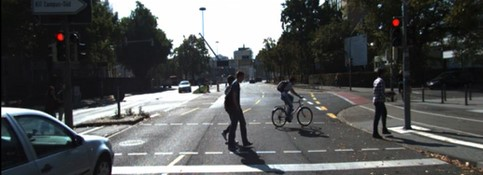

In [ ]:
img1=cv2.imread('/content/detectron2_pfe_img.jpg')
cv2_imshow(img1)


* The predictions have been made, let's visualize them. We can do this using Detectron2's Vizualizer class.

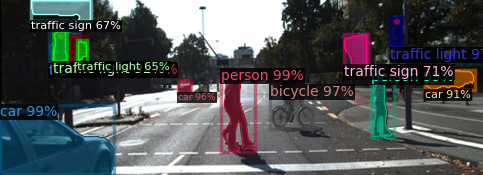

In [ ]:
from detectron2.utils.visualizer import ColorMode

im = cv2.imread('/content/detectron2_pfe_img.jpg')
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
v = Visualizer(im[:, :, ::-1],
                metadata=metadata,
                scale=1,
                #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

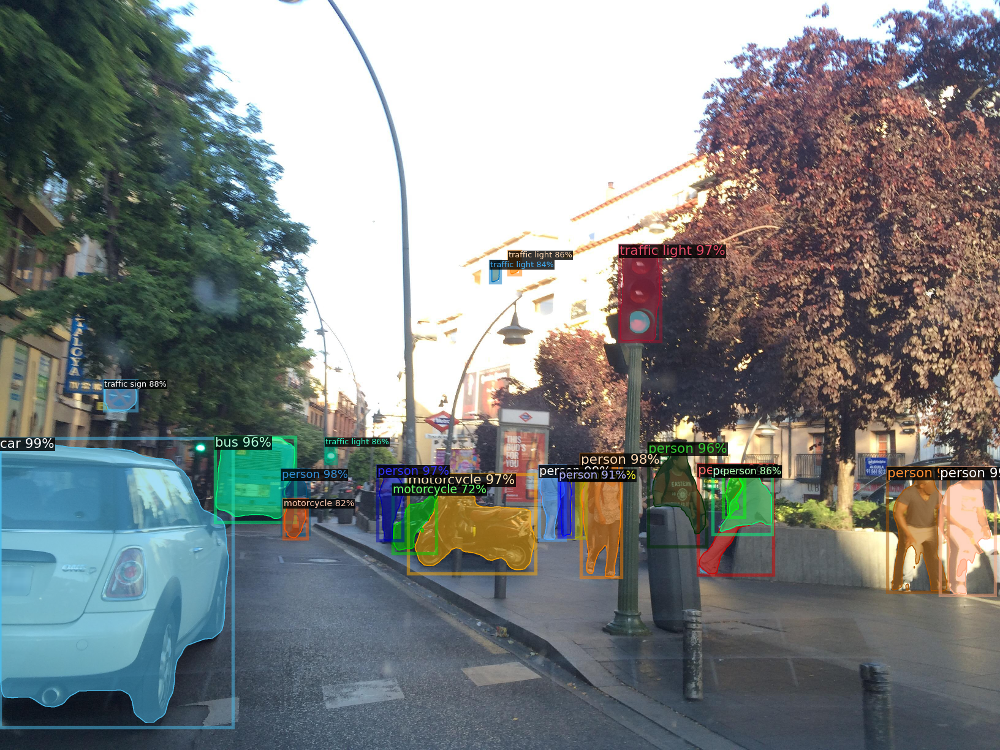

In [ ]:
from detectron2.utils.visualizer import ColorMode

im = cv2.imread('img5.jpg')
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
v = Visualizer(im[:, :, ::-1],
                metadata=metadata,
                scale=0.5,
                #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

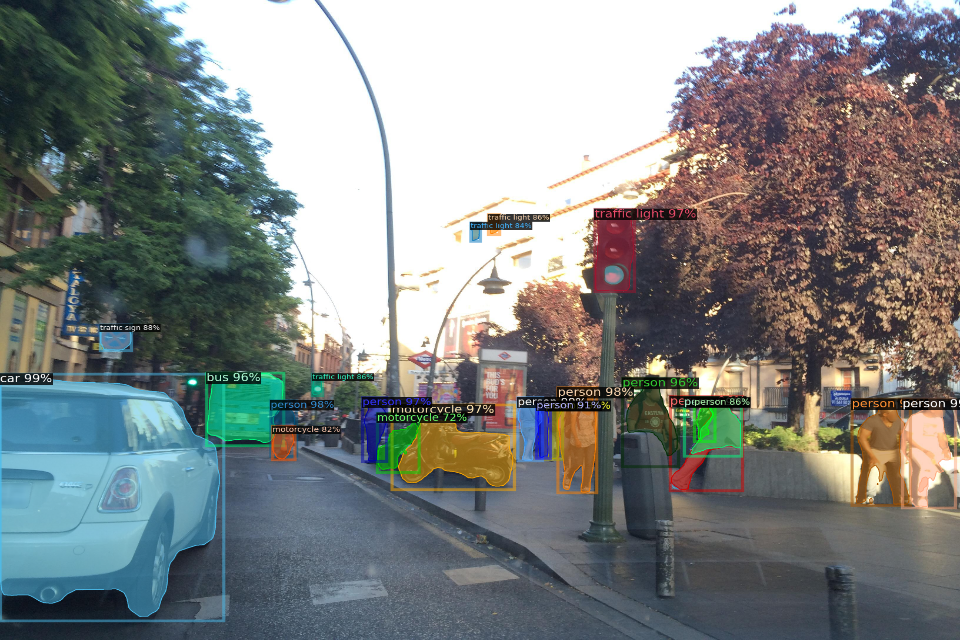

In [ ]:
imS = cv2.resize(out.get_image()[:, :, ::-1], (960, 640))
cv2_imshow(imS)

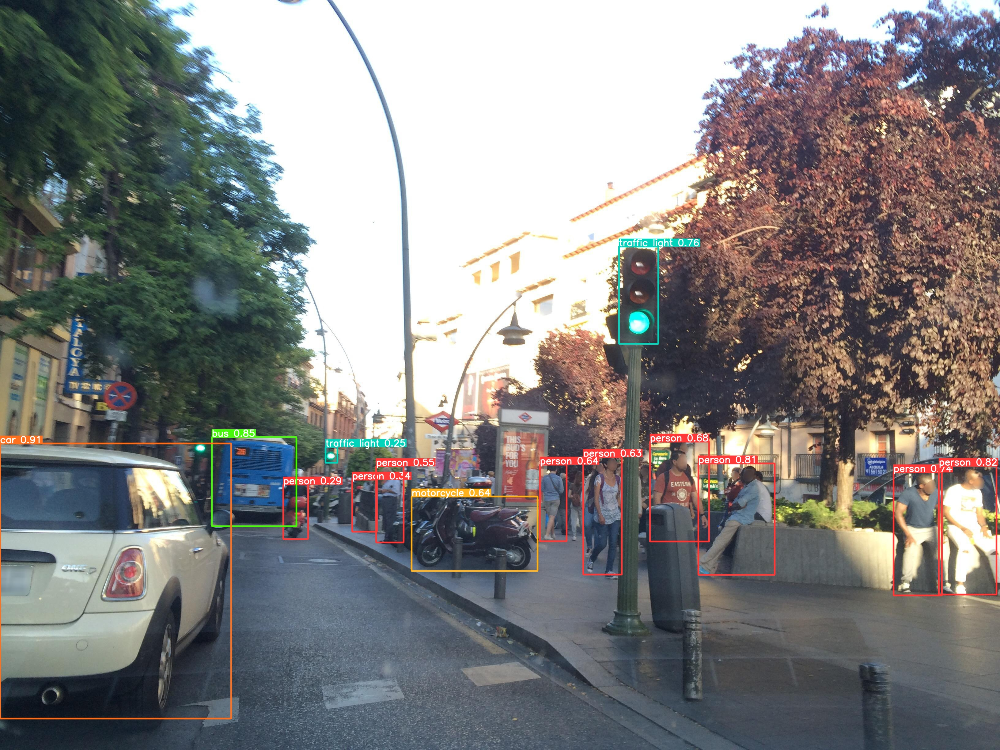

In [ ]:
img0 = cv2.imread('image1.jpg')
cv2_imshow(img0)


In [ ]:
# Save config to file
with open("output/config.yaml", "w") as f:
    f.write(cfg.dump())

In [ ]:
# Make a prediction and display inferences
def make_inference(image0, model_weights,model_config, threshold=0.5, n=5):

  """
  Makes inference on image (single image) using model_config, model_weights and threshold.

  Returns image with n instance predictions drawn on.

  Params:
  -------
  image (str) : file path to target image
  model_config (str) : file path to model config in .yaml format
  model_weights (str) : file path to model weights
  threshold (float) : confidence threshold for model prediction, default 0.5
  n (int) : number of prediction instances to draw on, default 5
    Note: some images may not have 5 instances to draw on depending on threshold,
    n=5 means the top 5 instances above the threshold will be drawn on.
  save (bool) : if True will save image with predicted instances to file, default False
  """

  # Setup config
  cfg = get_cfg()
  cfg.merge_from_file(model_config)
  cfg.MODEL.WEIGHTS = model_weights
  cfg.MODEL.SCORE_THRESH_TEST = threshold

  # Setup predictor
  predictor = DefaultPredictor(cfg)
  img0 = cv2.imread(image0)
  visualizer = Visualizer(im[:, :, ::-1],
                   metadata=metadata,
                   scale=0.5,
                   #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )

  outputs = predictor(img0) # Outputs: https://detectron2.readthedocs.io/modules/structures.html#detectron2.structures.Instances

  # Draw on predictions to image

  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

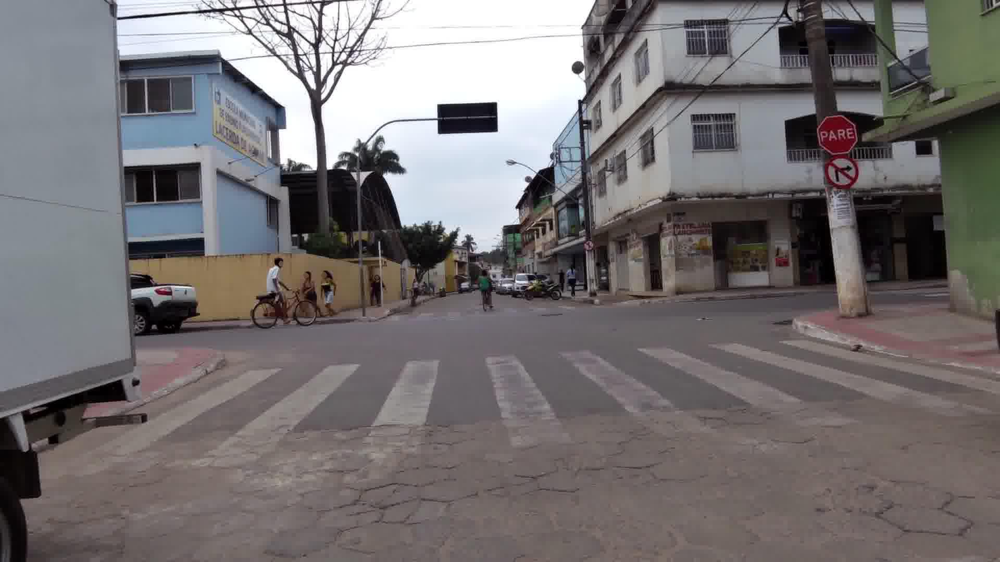

In [ ]:
# Get an example image from the wild (my kitchen) of a coffeemaker
cmaker = cv2.imread("test.jpg")
cv2_imshow(cmaker)

In [ ]:
# Make a prediction with the custom model
make_inference("test.jpg",
               model_weights="/content/model_0004899.pth",
               n=1)

TypeError: ignored

In [ ]:
from detectron2.utils.visualizer import ColorMode

im = cv2.imread('img5.jpg')
outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
v = Visualizer(im[:, :, ::-1],
                metadata=metadata,
                scale=0.5,
                #instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
import cv2
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode

video_input_path = "/content/Craziest Object on Road Ahead warning from Waze ever!.mp4"  # Replace with your input video file path
video_output_path = "output1_video.mp4"  # Replace with the desired output video file path

video = cv2.VideoCapture(video_input_path)
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = video.get(cv2.CAP_PROP_FPS)
total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
codec = cv2.VideoWriter_fourcc(*"mp4v")

out_video = cv2.VideoWriter(video_output_path, codec, fps, (width, height))

metadata = MetadataCatalog.get("mydata2")  # Replace with the metadata for your dataset
video_visualizer = VideoVisualizer(metadata, instance_mode=ColorMode.IMAGE)

frame_count = 0
while video.isOpened():
    ret, frame = video.read()

    if not ret:
        break

    outputs = predictor(frame)
    vis_frame = video_visualizer.draw_instance_predictions(frame, outputs["instances"].to("cpu"))
    out_video.write(vis_frame.get_image()[:, :, ::-1])  # Convert VisImage to NumPy array and switch BGR to RGB

    frame_count += 1
    progress = (frame_count / total_frames) * 100
    print(f"Progress: {progress:.2f}%")

video.release()
out_video.release()
cv2.destroyAllWindows()

# section for video

In [ ]:
!pip install pytube

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 kB 2.7 MB/s eta 0:00:00


In [ ]:
from pytube import YouTube

url = "https://youtu.be/Vjw0XzER9qM"  # Replace with the YouTube video URL you want to download
save_path = "/content/"  # Replace with the desired path to save the video

yt = YouTube(url)
video = yt.streams.get_highest_resolution()

print(f"Downloading {video.title}...")
video.download(save_path)
print(f"Downloaded {video.title} successfully!")

Downloaded Craziest "Object on Road Ahead" warning from Waze ever! successfully!


In [ ]:
# This is the video we're going to process
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("https://youtu.be/Vjw0XzER9qM", width=500)
display(video)

In [ ]:
# Install dependencies, download the video, and crop 5 seconds for processing
!pip install youtube-dl
!youtube-dl https://youtu.be/Vjw0XzER9qM -f 22 -o video.mp4
!ffmpeg -i video.mp4 -t 00:00:06 -c:v copy video-clip.mp4

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
[youtube] Vjw0XzER9qM: Downloading webpage
ERROR: Unable to extract uploader id; please report this issue on https://yt-dl.org/bug . Make sure you are using the latest version; see  https://yt-dl.org/update  on how to update. Be sure to call youtube-dl with the --verbose flag and include its complete output.
ffmpeg version 4.2.7-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.4.0-1ubuntu1~20.04.1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --ena

In [ ]:
# Run frame-by-frame inference demo on this video (takes 3-4 minutes) with the "demo.py" tool we provided in the repo.
!git clone https://github.com/facebookresearch/detectron2
# Note: this is currently BROKEN due to missing codec. See https://github.com/facebookresearch/detectron2/issues/2901 for workaround.
%run detectron2/demo/demo.py --config-file detectron2/configs/COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml --video-input video-clip.mp4 --confidence-threshold 0.6 --output video-output.mkv \
  --opts MODEL.WEIGHTS detectron2://COCO-PanopticSegmentation/panoptic_fpn_R_101_3x/139514519/model_final_cafdb1.pkl

In [ ]:
# Download the results
from google.colab import files
files.download('video-output.mkv')

## hi


In [ ]:
import cv2
from detectron2.utils.video_visualizer import VideoVisualizer
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import ColorMode

video_input_path = "/content/Craziest Object on Road Ahead warning from Waze ever!.mp4"  # Replace with your input video file path
video_output_path = "output1_video.mp4"  # Replace with the desired output video file path

video = cv2.VideoCapture(video_input_path)
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = video.get(cv2.CAP_PROP_FPS)
total_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
codec = cv2.VideoWriter_fourcc(*"mp4v")

out_video = cv2.VideoWriter(video_output_path, codec, fps, (width, height))

metadata = MetadataCatalog.get("mydata2")  # Replace with the metadata for your dataset
video_visualizer = VideoVisualizer(metadata, instance_mode=ColorMode.IMAGE)

frame_count = 0
while video.isOpened():
    ret, frame = video.read()

    if not ret:
        break

    outputs = predictor(frame)
    vis_frame = video_visualizer.draw_instance_predictions(frame, outputs["instances"].to("cpu"))
    out_video.write(vis_frame.get_image()[:, :, ::-1])  # Convert VisImage to NumPy array and switch BGR to RGB

    frame_count += 1
    progress = (frame_count / total_frames) * 100
    print(f"Progress: {progress:.2f}%")

video.release()
out_video.release()
cv2.destroyAllWindows()

Progress: 0.09%
Progress: 0.18%
Progress: 0.27%
Progress: 0.37%
Progress: 0.46%
Progress: 0.55%
Progress: 0.64%
Progress: 0.73%
Progress: 0.82%
Progress: 0.91%
Progress: 1.01%
Progress: 1.10%
Progress: 1.19%
Progress: 1.28%
Progress: 1.37%
Progress: 1.46%
Progress: 1.56%
Progress: 1.65%
Progress: 1.74%
Progress: 1.83%
Progress: 1.92%
Progress: 2.01%
Progress: 2.10%
Progress: 2.20%
Progress: 2.29%
Progress: 2.38%
Progress: 2.47%
Progress: 2.56%
Progress: 2.65%
Progress: 2.74%
Progress: 2.84%
Progress: 2.93%
Progress: 3.02%
Progress: 3.11%
Progress: 3.20%
Progress: 3.29%
Progress: 3.39%
Progress: 3.48%
Progress: 3.57%
Progress: 3.66%
Progress: 3.75%
Progress: 3.84%
Progress: 3.93%
Progress: 4.03%
Progress: 4.12%
Progress: 4.21%
Progress: 4.30%
Progress: 4.39%
Progress: 4.48%
Progress: 4.57%
Progress: 4.67%
Progress: 4.76%
Progress: 4.85%
Progress: 4.94%
Progress: 5.03%
Progress: 5.12%
Progress: 5.22%
Progress: 5.31%
Progress: 5.40%
Progress: 5.49%
Progress: 5.58%
Progress: 5.67%
Progress

In [ ]:
import shutil
shutil.copyfile("/content/output1_video.mp4","/content/drive/MyDrive/shared_video_detectron2/output1_video.mp4")

'/content/drive/MyDrive/shared_video_detectron2/output1_video.mp4'

In [ ]:
#import shutil
#shutil.copyfile("/content/drive/MyDrive/sharedFolder_aws/5th/model_0004899.pth","/content/model_0004899.pth")

In [ ]:
'''
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 9  # Update this with the number of classes in your dataset
cfg.MODEL.WEIGHTS = "/content/model_0008999.pth"  # Update this with the path to your saved checkpoint
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)
'''

[04/24 10:28:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/model_0008999.pth ...
